# The Single-Cell Spatial Transcriptomics Analysis (ScSTA) Cookbook

```
Arun Das
Postdoctoral Associate
Hillman Cancer Center
University of Pittsburgh Medical Center
```

## Install packages

## Import packages

In [1]:
%matplotlib inline
import warnings
# Suppress all warnings
warnings.filterwarnings('ignore')

import os
import matplotlib.pyplot as plt
import seaborn as sns

from napari_spatialdata import Interactive
from spatialdata import SpatialData

from pathlib import Path
import scanpy as sc
import decoupler as dc
import numpy as np
import squidpy as sq
import pandas as pd

import tqdm as notebook_tqdm

pd.set_option("display.max_columns", None)
# Plotting options, change to your liking
sc.settings.set_figure_params(dpi=80, frameon=False, facecolor="white")
sc.set_figure_params(dpi=80)
sc.set_figure_params(figsize=(4, 4))
sc.settings.verbosity = 0

## Download CosMx SMI NSCLC FFPE Dataset for analysis

In [2]:
nanostring_dir = Path().resolve() / "tutorial_data" / "nanostring_data"
sample_dir = nanostring_dir / "Lung9_Rep1" / "Lung9_Rep1-Flat_files_and_images"

adata = sq.read.nanostring(
    path=sample_dir,
    counts_file="Lung9_Rep1_exprMat_file.csv",
    meta_file="Lung9_Rep1_metadata_file.csv",
    fov_file="Lung9_Rep1_fov_positions_file.csv",
)

In [3]:
adata

AnnData object with n_obs × n_vars = 91972 × 980
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_fov'

In [4]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell_ID
1_1,1,1492,1.80,1760.333333,140388.555556,54,30,8246,12492,794,1892,209,1155,380,998,310,1298,1
2_1,1,4191,2.20,1913.333333,140378.555556,112,51,7377,16475,4133,13419,100,7803,79,335,332,942,2
3_1,1,4566,0.97,2157.333333,140364.555556,76,78,9058,13283,700,3906,116,1023,175,751,443,1814,3
4_1,1,4288,1.48,2350.333333,140372.555556,92,62,8677,12168,702,1921,125,1144,297,1292,643,1467,4
5_1,1,1118,1.52,2483.333333,140387.555556,50,33,9498,12022,678,5281,103,962,297,901,386,1005,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4048_20,20,1665,1.61,21780.000000,151375.555556,61,38,11185,24445,2597,12112,191,454,92,444,339,925,4048
4049_20,20,1957,1.79,22551.000000,151376.555556,70,39,8754,26648,1499,6045,170,491,66,377,409,1033,4049
4050_20,20,1312,1.29,22803.000000,151374.555556,45,35,7440,20598,1285,3026,158,438,70,344,448,855,4050
4051_20,20,891,1.45,22157.000000,151371.555556,42,29,10534,24978,2696,6279,157,498,62,281,183,702,4051


## Load the cell type information for the NSCLC sample

In [5]:
df = pd.read_csv(f'{sample_dir}/Lung9_Rep1_ctypes.csv', index_col=0)
df.index = [f'{str(c)}_{str(fov)}' for c,fov in zip(df['cell_ID'], df['fov'])]
df

,fov,Area,AspectRatio,Width,Height,cell_ID,cell_type
2_1,1,4191,2.20,112,51,2,tumor 9
3_1,1,4566,0.97,76,78,3,epithelial
4_1,1,4288,1.48,92,62,4,neutrophil
6_1,1,1708,1.33,56,42,6,neutrophil
7_1,1,2562,0.95,57,60,7,neutrophil
...,...,...,...,...,...,...,...
4048_20,20,1665,1.61,61,38,4048,tumor 9
4049_20,20,1957,1.79,70,39,4049,tumor 9
4050_20,20,1312,1.29,45,35,4050,tumor 9
4051_20,20,891,1.45,42,29,4051,tumor 9


## Combine the cell type information with the gene expressions

In [6]:
adata_ctype = pd.merge(adata.obs, df['cell_type'], how='outer', right_index=True, left_index=True)
adata_ctype = adata_ctype.drop_duplicates()
adata_ctype['cell_type'].fillna('unknown', inplace=True)
adata_ctype.replace({k:'tumor' for k in ['tumor '+ str(i) for i in [5, 6, 9, 12, 13]]}, inplace=True)
adata_ctype = adata_ctype.loc[adata.obs.index]

for column_name in adata_ctype.columns:
    if column_name in adata.obs.columns:
        new_dtype = adata.obs[column_name].dtype
        adata_ctype[column_name] = adata.obs[column_name].astype(new_dtype)
        
adata.obs = adata_ctype


## Quality Control

In [7]:
adata.var["NegPrb"] = adata.var_names.str.startswith("NegPrb")
sc.pp.calculate_qc_metrics(adata, qc_vars=["NegPrb"], inplace=True)

In [8]:
adata.obs["total_counts_NegPrb"].sum() / adata.obs["total_counts"].sum() * 100

0.33919046849384654

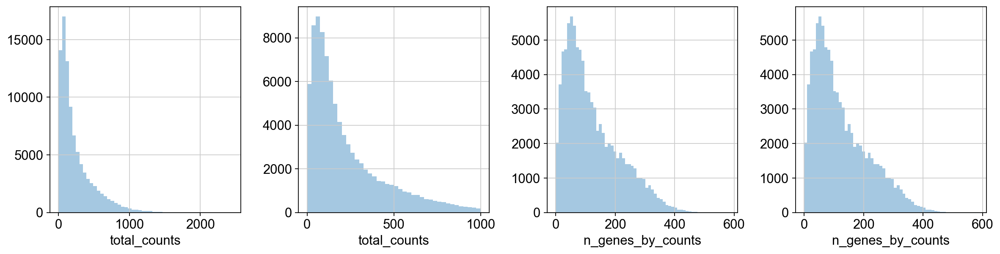

In [9]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata.obs["total_counts"][adata.obs["total_counts"] < 1000], kde=False, bins=40, ax=axs[1])
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])

plt.tight_layout()

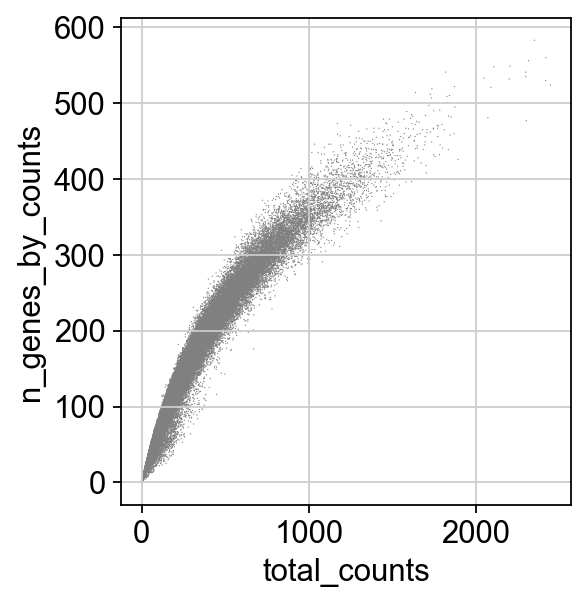

In [10]:
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

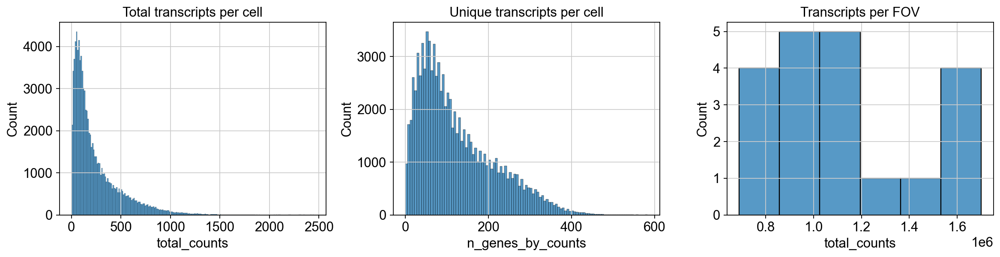

In [11]:
fig, axs = plt.subplots(1, 3, figsize=(15, 4))

axs[0].set_title("Total transcripts per cell")
sns.histplot(
    adata.obs["total_counts"],
    kde=False,
    ax=axs[0],
)

axs[1].set_title("Unique transcripts per cell")
sns.histplot(
    adata.obs["n_genes_by_counts"],
    kde=False,
    ax=axs[1],
)

axs[2].set_title("Transcripts per FOV")
sns.histplot(
    adata.obs.groupby("fov")["total_counts"].sum(),
    kde=False,
    ax=axs[2],
)

plt.tight_layout()

## Morphology Image Summary

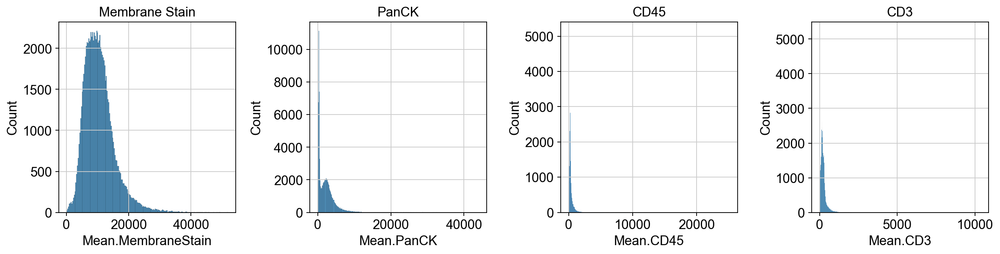

In [12]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))

axs[0].set_title("Membrane Stain")
sns.histplot(
    adata.obs["Mean.MembraneStain"],
    kde=False,
    ax=axs[0],
)

axs[1].set_title("PanCK")
sns.histplot(
    adata.obs["Mean.PanCK"],
    kde=False,
    ax=axs[1],
)

axs[2].set_title("CD45")
sns.histplot(
    adata.obs["Mean.CD45"],
    kde=False,
    ax=axs[2],
)

axs[3].set_title("CD3")
sns.histplot(
    adata.obs["Mean.CD3"],
    kde=False,
    ax=axs[3],
)

plt.tight_layout()

## Filter the cells and genes

In [13]:
sc.pp.filter_cells(adata, min_counts=100)
sc.pp.filter_genes(adata, min_cells=100)

In [14]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell_ID,cell_type,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_counts
9_1,1,3431,2.22,2964.333333,140380.555556,102,46,7506,11281,1855,7376,145,819,107,340,380,1222,9,tumor,103,4.644391,131,4.882802,59.541985,97.709924,100.0,100.0,0,0.000000,0.000000,131
10_1,1,2240,1.26,3334.333333,140378.555556,63,50,9750,13472,1950,7221,131,1048,76,261,697,1598,10,tumor,122,4.812184,200,5.303305,64.000000,89.000000,100.0,100.0,0,0.000000,0.000000,200
11_1,1,1883,1.56,3397.333333,140381.555556,70,45,9772,18072,1734,6853,409,1969,106,298,446,1198,11,tumor,94,4.553877,129,4.867534,65.891473,100.000000,100.0,100.0,0,0.000000,0.000000,129
15_1,1,3494,1.52,5192.333333,140373.555556,91,60,8333,13351,2830,7590,197,925,109,356,334,1143,15,tumor,154,5.043425,275,5.620401,60.363636,80.363636,100.0,100.0,0,0.000000,0.000000,275
16_1,1,1927,1.28,5451.333333,140380.555556,59,46,9181,13267,3950,10967,412,4549,130,809,167,875,16,tumor,94,4.553877,127,4.852030,65.354331,100.000000,100.0,100.0,1,0.693147,0.787402,127
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4045_20,20,5545,2.80,19065.000000,151382.555556,143,51,6587,14048,2958,18370,208,505,99,408,265,937,4045,tumor,143,4.969813,301,5.710427,65.448505,85.714286,100.0,100.0,0,0.000000,0.000000,301
4046_20,20,2909,1.78,22010.000000,151381.555556,87,49,8689,24962,1577,8804,218,618,90,522,384,912,4046,tumor,159,5.075174,281,5.641907,59.074733,79.003559,100.0,100.0,1,0.693147,0.355872,281
4048_20,20,1665,1.61,21780.000000,151375.555556,61,38,11185,24445,2597,12112,191,454,92,444,339,925,4048,tumor,111,4.718499,157,5.062595,61.146497,92.993631,100.0,100.0,0,0.000000,0.000000,157
4049_20,20,1957,1.79,22551.000000,151376.555556,70,39,8754,26648,1499,6045,170,491,66,377,409,1033,4049,tumor,89,4.499810,124,4.828314,68.548387,100.000000,100.0,100.0,0,0.000000,0.000000,124


## Carry out Preprocessing

In [15]:
adata.layers["counts"] = adata.X.copy()

### Normalize the data based on the total reads

In [16]:
sc.pp.normalize_total(adata)

### Log normalize the dataset

In [17]:
sc.pp.log1p(adata)

### Find the highly variable genes

In [18]:
sc.pp.highly_variable_genes(adata)

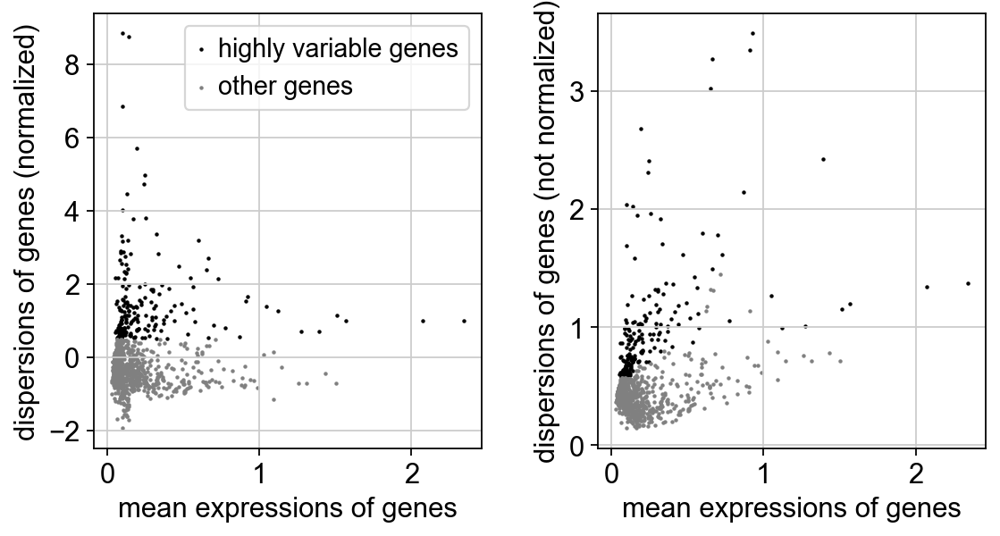

In [19]:
sc.pl.highly_variable_genes(adata)

### Carry out PCA to reduce the dimensions of the dataset

In [20]:
sc.pp.pca(adata, svd_solver='arpack')

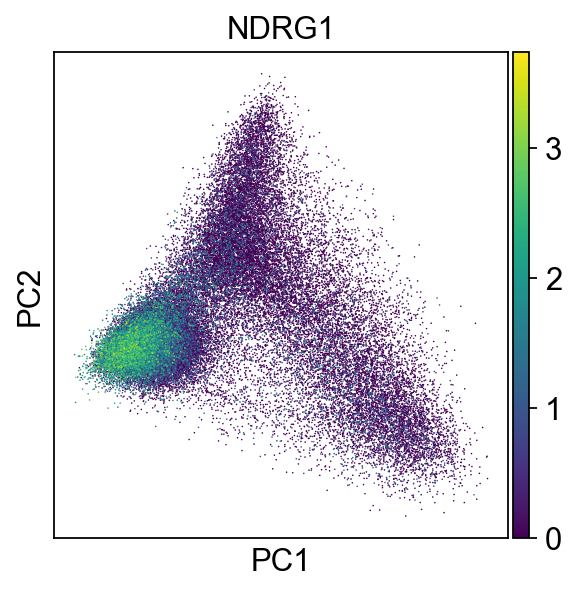

In [21]:
sc.pl.pca(adata, color='NDRG1')

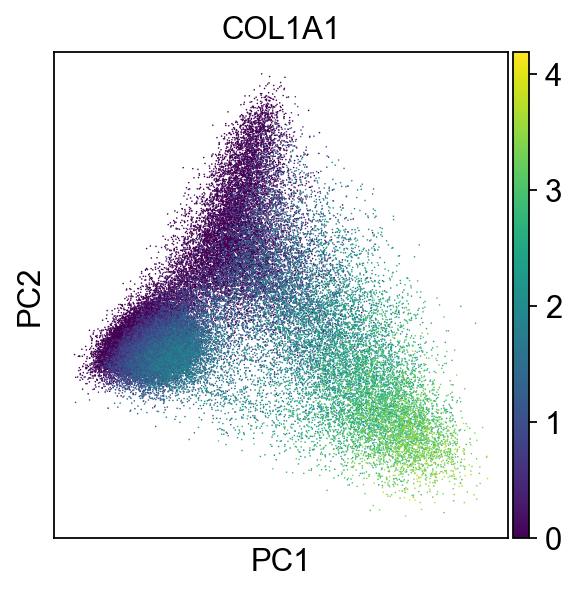

In [22]:
sc.pl.pca(adata, color='COL1A1')

### Compute the neighborhood graph

In [23]:
sc.pp.neighbors(adata, n_neighbors=100)

In [24]:
adata

AnnData object with n_obs × n_vars = 60268 × 980
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'cell_type', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_counts'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'log1p', 'hvg', 'pca', 'neighbors'
    obsm: 'spatial', 'spatial_fov', 'X_pca'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

### Compute the UMAP

In [25]:
sc.tl.umap(adata)

### Cluster the UMAP

#### We can use any clustering algorithms here. Two of the most popular are Leiden and Louvain.

In [26]:
sc.tl.leiden(adata)

In [27]:
sc.tl.louvain(adata)

In [ ]:
sc.pl.umap(
    adata,
    color=[
        "total_counts",
        "n_genes_by_counts",
        "leiden",
        "louvain",
    ],
    wspace=0.4,
)

## Plot the UMAP and paint each cell by the cell-type

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

sc.pl.umap(
    adata,
    color=[
        'cell_type'
    ], size=10,
    wspace=0.4, ax=ax, palette='tab20'
)


# Spatial Plots

In [30]:
def generate_list(length, cols):
    # Calculate the number of rows needed to accommodate the length and cols
    rows = length // cols
    if length % cols != 0:
        rows += 1

    # Initialize an empty list to store the result
    result = []

    # Loop through each row and column
    for row in range(rows):
        row_values = []
        # Calculate the starting and ending values for the current row
        start = length - row * cols
        end = start - cols + 1

        # Add the values for the current row to the row_values list in reverse order
        row_values.extend(range(start, end - 1, -1))

        # Extend the result list with the reversed row_values
        result.extend(reversed(row_values))

    return result

## Plot the leiden clusters of two FOVs

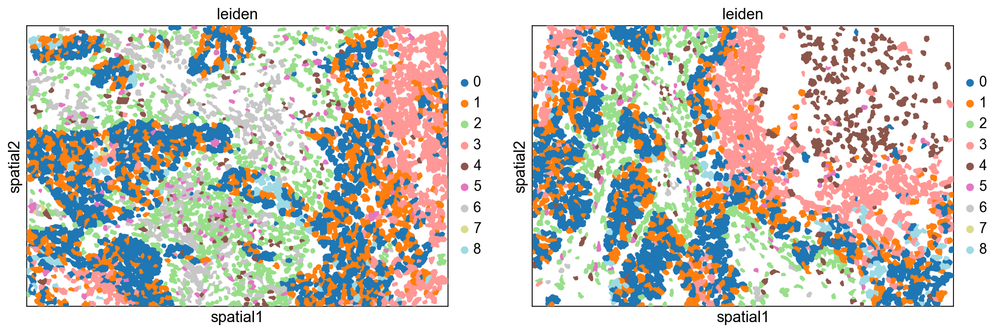

In [31]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

for _ax in ax:
    _ax.set_facecolor('white')

sq.pl.spatial_segment(
    adata,
    shape="hex",
    color="leiden",
    library_key="fov",
    library_id="13",
    seg_cell_id="cell_ID",
    img=False,
    size=60,
    ax=ax[0],
    palette='tab20',

)

sq.pl.spatial_segment(
    adata,
    color="leiden",
    seg_cell_id="cell_ID",
    library_key="fov",
    library_id="15",
    img=False,
    size=60,
    ax=ax[1],
    
)

## Plot the spatial map of the leiden cluster for the whole slide

In [ ]:
plot_focus = "leiden"

axs_scatter = sq.pl.spatial_segment(
    adata,
    color=plot_focus,
    library_key="fov",
    library_id = [f"{i}" for i in generate_list(20, 4)],
    seg_cell_id="cell_ID", 
    seg_outline = True,
    palette='tab20',
    img=False,
    colorbar=False,
    hspace=0, wspace=0,
    ncols=4,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(10,6),
    library_first=True,
    frameon=False,
    title=None,
    return_ax = True
)

# Get the current Matplotlib axes object
for ax in axs_scatter:    
    # Remove the title from the Matplotlib axes
    ax.set_title("")

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0, wspace=0)

# Optionally, tighten the layout
plt.tight_layout()

plt.savefig(os.path.join(sample_dir, 'generated_figures', f'whole_tissue_{plot_focus}.png'), dpi=200)
# Show or save the plot
plt.show()

## Plot the spatial map of cell types

In [ ]:
plot_focus = "cell_type"

axs_scatter = sq.pl.spatial_segment(
    adata,
    color=plot_focus,
    library_key="fov",
    library_id = [f"{i}" for i in generate_list(20, 4)],
    seg_cell_id="cell_ID", 
    seg_outline = True,
    palette='tab20',
    img=False,
    colorbar=False,
    hspace=0, wspace=0,
    ncols=4,
    legend_loc=None,
    outline=False,
    axis_label = None,
    figsize=(10,6),
    # library_first=True,
    frameon=False,
    title=None,
    return_ax = True
)

# Get the current Matplotlib axes object
for ax in axs_scatter:    
    # Remove the title from the Matplotlib axes
    ax.set_title("")

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0, wspace=0)

# Optionally, tighten the layout
# plt.tight_layout()

# plt.savefig(os.path.join(sample_dir, 'generated_figures', f'whole_tissue_{plot_focus}.png'), dpi=200)
# Show or save the plot
plt.show()

## Plot the spatial map of the PanCK staining intensity

In [ ]:
sq.pl.spatial_segment(
    adata,
    color="Max.PanCK",
    library_key="fov",
    library_id=['20', '19', '18', '17'],
    seg_cell_id="cell_ID", 
    figsize=(10,10),
    hspace=0, 
    wspace=0,
    ncols=4,
    colorbar=None,
    cmap='viridis',
    axis_label=None
)

In [ ]:
sq.pl.spatial_segment(
    adata,
    color="Max.PanCK",
    library_key="fov",
    library_id=["14"],
    seg_cell_id="cell_ID", 
    figsize=(10,10),
    hspace=0, 
    wspace=0,
    ncols=4,
    colorbar=None,
    cmap='viridis',
    axis_label=None
)

plt.savefig(os.path.join(sample_dir, 'generated_figures', f'fov-14_Max.PanCK.png'), dpi=200)


## Plot the spatial map of cell types as a scatter plot

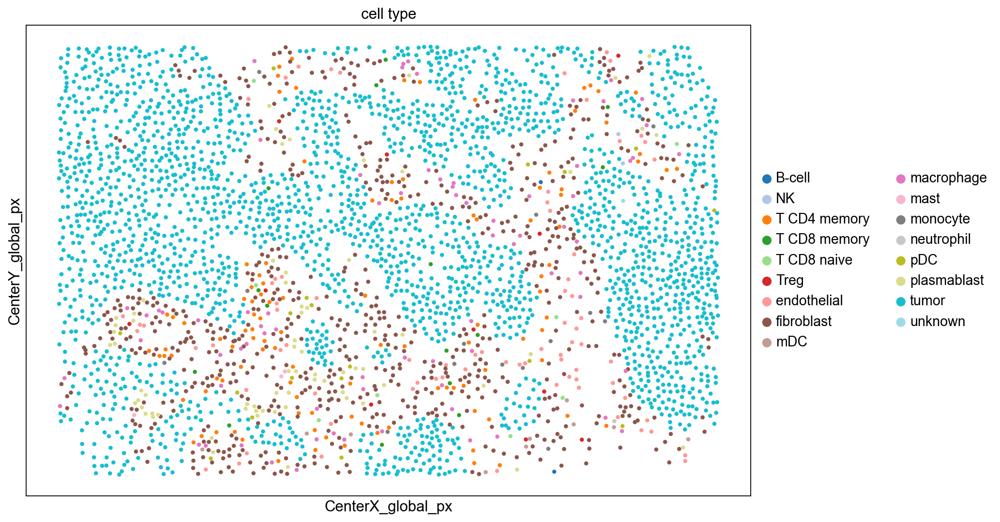

In [38]:
adata_sub = adata[adata.obs['fov'].isin(['14'])]

fig, ax = plt.subplots(1, 1, figsize=(12, 8))

# Create the scatter plot without grid lines
sc.pl.scatter(
    adata_sub,
    x='CenterX_global_px',
    y='CenterY_global_px',
    color='cell_type',
    show=False, 
    size=60,
    ax = ax,
)

# Turn off x and y axes
ax.set_xticks([])
ax.set_yticks([])

plt.savefig(os.path.join(sample_dir, 'generated_figures', f'fov-14_cell_types.png'), dpi=200)


### Plot the spatial map of cell segmentations and cell types

[]

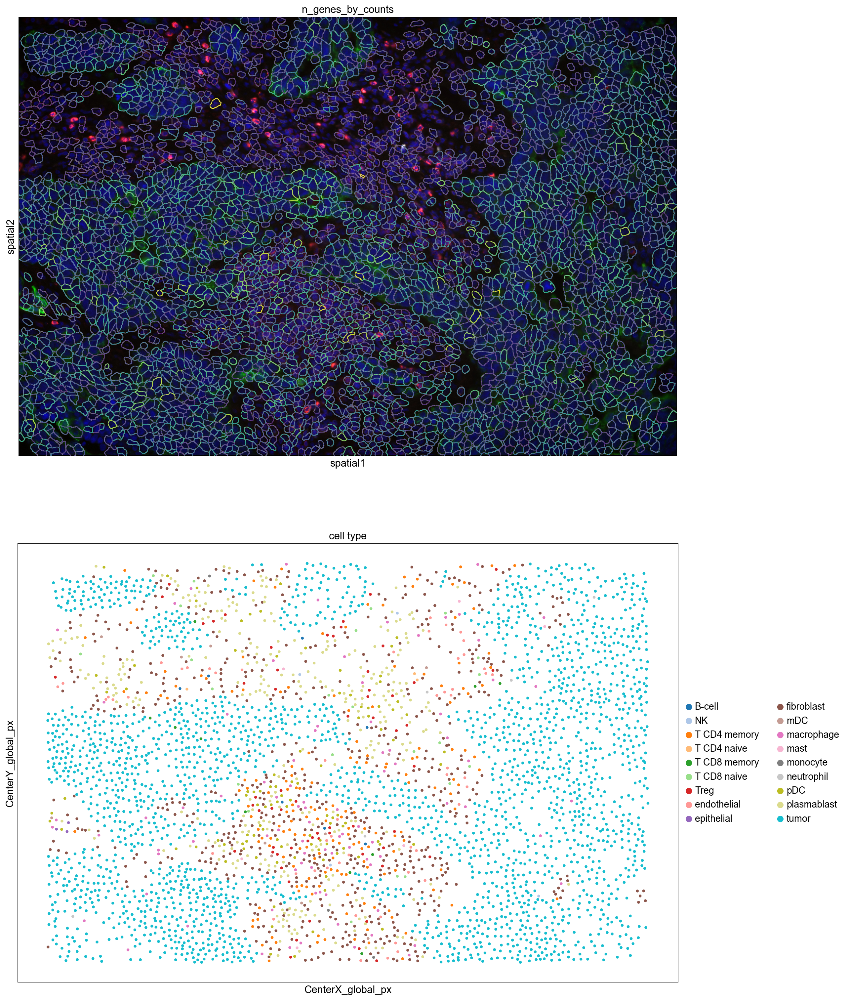

In [39]:
fig, ax = plt.subplots(2, 1, figsize=(16, 24))

fov = 13

sq.pl.spatial_segment(
    adata,
    color="n_genes_by_counts",
    library_key="fov",
    library_id=str(fov),
    seg_cell_id="cell_ID",
    seg_contourpx=10,
    # crop_coord=[(0, 0, 700, 700)],
    figsize=(15,15),
    hspace=0, 
    wspace=0,
    colorbar=None,
    ax=ax[0]
)

adata_sub = adata[adata.obs['fov'].isin([str(fov)])]

# fig, ax = plt.subplots(1, 1, figsize=(12, 8))

# Create the scatter plot without grid lines
sc.pl.scatter(
    adata_sub,
    x='CenterX_global_px',
    y='CenterY_global_px',
    color='cell_type',
    show=False, 
    size=60,
    ax = ax[1], 
    frameon=False, 
    # legend_loc='none'
)

# Turn off x and y axes
ax[1].set_xticks([])
ax[1].set_yticks([])

### Plot the spatial map of cell types

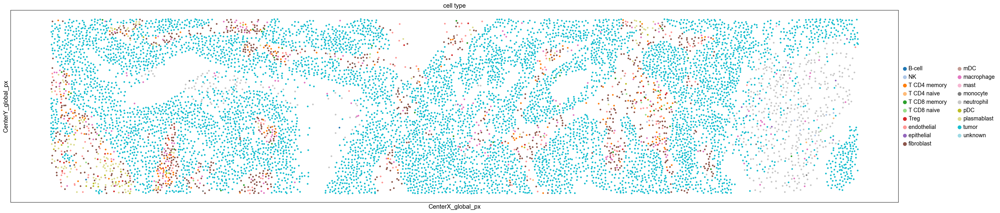

In [40]:
adata_sub = adata[adata.obs['fov'].isin(["19", "18", "17"])]

fig, ax = plt.subplots(1, 1, figsize=(12*3, 8))

# Create the scatter plot without grid lines
sc.pl.scatter(
    adata_sub,
    x='CenterX_global_px',
    y='CenterY_global_px',
    color='cell_type',
    show=False, 
    size=60,
    frameon=False, 
    ax=ax
    # legend_loc='none'
)

# Turn off x and y axes
ax.set_xticks([])
ax.set_yticks([])

plt.savefig(os.path.join(sample_dir, 'generated_figures', f'fov-19_18_17_celltypes.png'), dpi=200)


## Spatial Connectivity Analysis

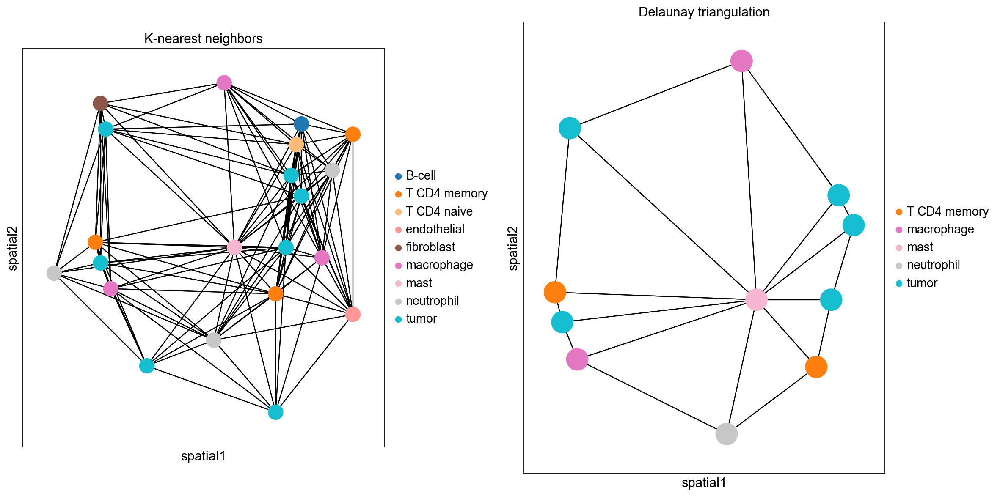

In [41]:
fig, ax = plt.subplots(1, 2, figsize=(15, 15))
sq.gr.spatial_neighbors(
    adata,
    n_neighs=15,
    coord_type="generic",
)
_, idx = adata.obsp["spatial_connectivities"][1111, :].nonzero()
idx = np.append(idx, 1111)
sq.pl.spatial_scatter(
    adata[idx, :],
    library_id="16",
    color="cell_type",
    connectivity_key="spatial_connectivities",
    size=3,
    edges_width=1,
    edges_color="black",
    img=False,
    title="K-nearest neighbors",
    ax=ax[0],
)

sq.gr.spatial_neighbors(
    adata,
    n_neighs=15,
    coord_type="generic",
    delaunay=True,
)
_, idx = adata.obsp["spatial_connectivities"][1111, :].nonzero()
idx = np.append(idx, 1111)
sq.pl.spatial_scatter(
    adata[idx, :],
    library_id="16",
    color="cell_type",
    connectivity_key="spatial_connectivities",
    size=3,
    edges_width=1,
    edges_color="black",
    img=False,
    title="Delaunay triangulation",
    ax=ax[1],
)

plt.tight_layout()

In [42]:
adata_spatial_neighbor = sq.gr.spatial_neighbors(
    adata, coord_type="generic", delaunay=True
)

In [43]:
sq.gr.centrality_scores(adata, cluster_key="cell_type")

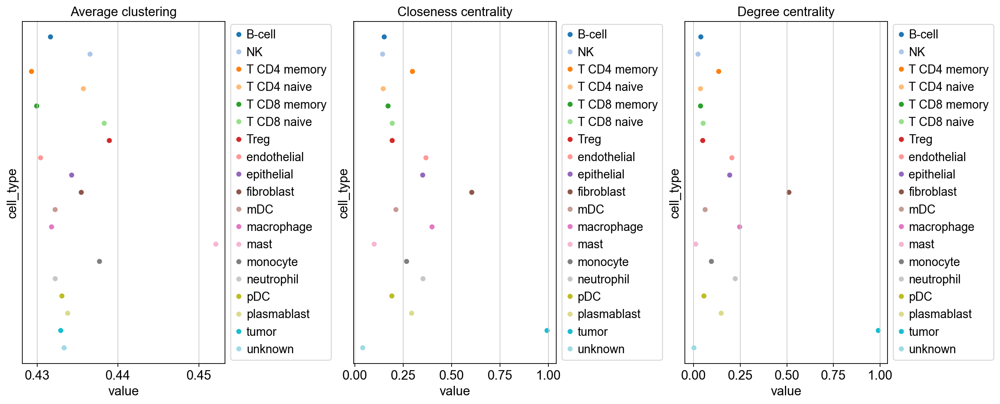

In [44]:
sq.pl.centrality_scores(adata, cluster_key="cell_type", figsize=(15, 6))

## Spatial Co-Occurance

In [45]:
adata_subset = adata[adata.obs.fov.isin(["15", "16", '19', '20'])].copy()

In [46]:
sq.gr.co_occurrence(
    adata_subset,
    cluster_key="cell_type",
)

  0%|          | 0/1 [00:00<?, ?/s]

In [ ]:
sq.pl.co_occurrence(
    adata_subset,
    cluster_key="cell_type",
    clusters='tumor', figsize=(15, 7), 
)

## Neighborhood Enrichment Analysis

In [48]:
sq.gr.nhood_enrichment(adata, cluster_key="cell_type")

  0%|          | 0/1000 [00:00<?, ?/s]

In [49]:
sq.gr.nhood_enrichment(adata_subset, cluster_key="cell_type")

  0%|          | 0/1000 [00:00<?, ?/s]

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(22, 22))
sq.pl.nhood_enrichment(
    adata,
    cluster_key="cell_type",
    figsize=(3, 3),
    ax=ax[0],
    title="Neighborhood enrichment adata",
)
sq.pl.nhood_enrichment(
    adata_subset,
    cluster_key="cell_type",
    figsize=(3, 3),
    ax=ax[1],
    title="Neighborhood enrichment adata_subset", cmap='RdBu_r'
)

plt.tight_layout()

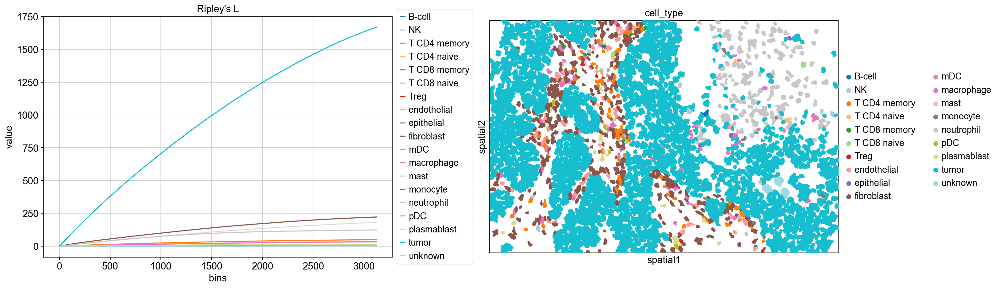

In [51]:
mode = "L"
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

sq.gr.ripley(adata_subset, cluster_key="cell_type", mode=mode)
sq.pl.ripley(
    adata_subset,
    cluster_key="cell_type",
    mode=mode,
    ax=ax[0],
)

sq.pl.spatial_segment(
    adata_subset,
    shape="hex",
    color="cell_type",
    library_id=["15"],
    library_key="fov",
    seg_cell_id="cell_ID",
    img=False,
    size=60,
    ax=ax[1],
)

plt.tight_layout()

## Spatial Correlation Analysis

In [52]:
sq.gr.spatial_neighbors(adata_subset, coord_type="generic", delaunay=True)
sq.gr.spatial_autocorr(
    adata_subset,
    mode="moran",
    n_perms=100,
    n_jobs=1,
)
adata_subset.uns["moranI"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]

,I,pval_norm,var_norm,pval_z_sim,pval_sim,var_sim,pval_norm_fdr_bh,pval_z_sim_fdr_bh,pval_sim_fdr_bh
NDRG1,0.121764,0.0,0.000029,0.0,0.009901,0.000025,0.0,0.0,0.016559
HSP90AB1,0.117837,0.0,0.000029,0.0,0.009901,0.000027,0.0,0.0,0.016559
SOX4,0.094409,0.0,0.000029,0.0,0.009901,0.000026,0.0,0.0,0.016559
COL3A1,0.092871,0.0,0.000029,0.0,0.009901,0.000022,0.0,0.0,0.016559
SLPI,0.089717,0.0,0.000029,0.0,0.009901,0.000022,0.0,0.0,0.016559
MMP1,0.089286,0.0,0.000029,0.0,0.009901,0.000020,0.0,0.0,0.016559
COL1A2,0.077185,0.0,0.000029,0.0,0.009901,0.000013,0.0,0.0,0.016559
COL1A1,0.076118,0.0,0.000029,0.0,0.009901,0.000020,0.0,0.0,0.016559
MIF,0.072038,0.0,0.000029,0.0,0.009901,0.000018,0.0,0.0,0.016559
DCN,0.068745,0.0,0.000029,0.0,0.009901,0.000017,0.0,0.0,0.016559


In [53]:
adata_subset.uns["moranI"].index[:10]

Index(['NDRG1', 'HSP90AB1', 'SOX4', 'COL3A1', 'SLPI', 'MMP1', 'COL1A2',
       'COL1A1', 'MIF', 'DCN'],
      dtype='object')

In [ ]:
sq.pl.spatial_segment(
    adata_subset,
    shape="hex",
     color=["NDRG1", "HSP90AB1", "SOX4"],
    library_id=["19"],
    library_key="fov",
    seg_cell_id="cell_ID", 
    palette=None,
    legend_loc=None,
    img=False,
    ncols=4,
    size=40,)

plt.tight_layout()

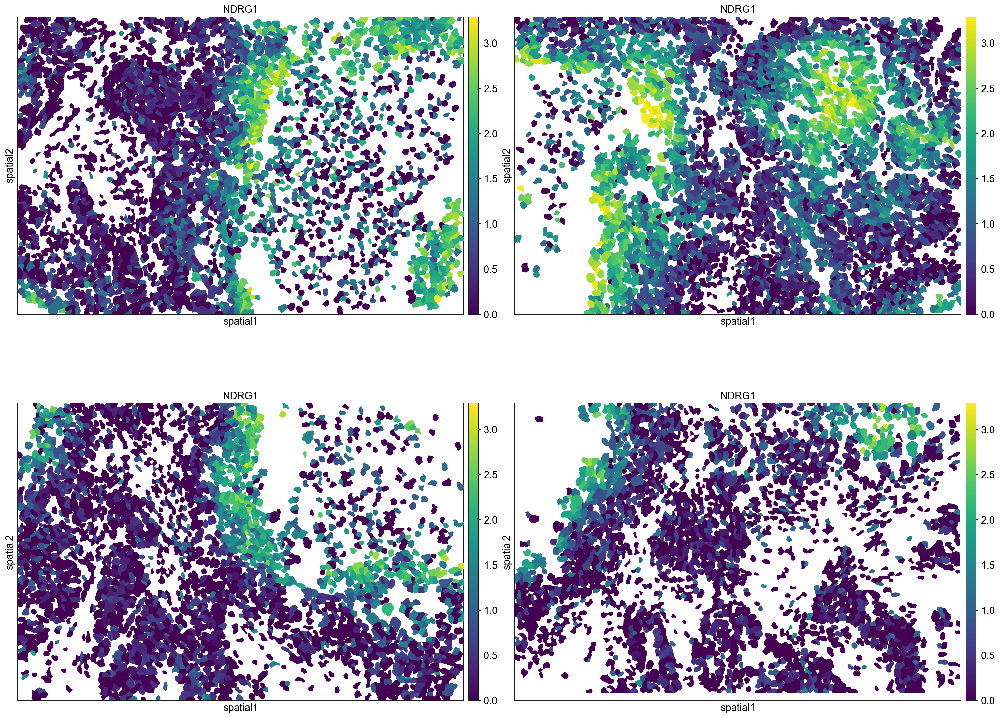

In [55]:
sq.pl.spatial_segment(
    adata_subset,
    shape="hex",
    color=["NDRG1"],
    library_id=["19", "20", "15", "16"],
    library_key="fov",
    seg_cell_id="cell_ID", 
    palette=None,
    legend_loc=None,
    img=False,
    ncols=2,
    size=40, wspace=0, hspace=0.3,
    figsize=(12, 8))

plt.tight_layout()

In [ ]:
sq.pl.spatial_segment(
    adata_subset,
    shape="hex",
    color=["HSP90AB1"],
    library_id=["19", "20", "15", "16"],
    library_key="fov",
    seg_cell_id="cell_ID", 
    palette=None,
    legend_loc=None,
    img=False,
    ncols=2,
    size=40, wspace=0, hspace=0.3,
    figsize=(12, 8))

plt.tight_layout()

In [ ]:
sq.pl.spatial_segment(
    adata_subset,
    shape="hex",
    color=['NDRG1', 'HSP90AB1', 'SOX4', 'COL3A1', 'SLPI', 'MMP1', 'COL1A2',
       'COL1A1', 'MIF', 'DCN'],
    library_id=["20"],
    library_key="fov",
    seg_cell_id="cell_ID", 
    palette=None,
    legend_loc=None,
    img=False,
    ncols=3,
    size=40, wspace=0, hspace=0.3,
    figsize=(12, 8))

plt.tight_layout()